Take a clustering solution and explore it using the provided classification

In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
plt.style.use('ggplot')
import warnings
warnings.filterwarnings("ignore")

%matplotlib inline
%load_ext autoreload
%autoreload 2

# Basics
import scipy.stats
import pickle, codecs, csv, copy
from collections import OrderedDict
import numpy as np
import pandas as pd
import seaborn as sns
#sns.set_context("paper")
import random
random.seed(100)

In [2]:
from igraph import *
import louvain

In [3]:
# load data
metadata = pickle.load(open("dataset/citation_data.p","rb"))
print(len(metadata)) # 37626

# Load classification of citing publications
citers = "dataset/citers_subjects.csv"
citers_info = dict()
with codecs.open(citers, "r", encoding="utf-8") as f:
    csv_reader = csv.reader(f,delimiter=';', quotechar='"')
    next(csv_reader, None)  # skip the headers
    for row in csv_reader:
        if len(row) < 9:
            continue
        bid,author,year,title_corrected,general_category,keywords,typology,periods,subjects = row
        keywords = [x.strip() for x in keywords.split(";")]
        periods = [x.strip() for x in periods.split(";")]
        citers_info[bid] = {"title_corrected":title_corrected,"general_category":general_category,"keywords":keywords,
                           "typology":typology,"periods":periods,"subjects":subjects}
print(len(citers_info)) #673

# Load core literature
import csv
core_filename = "dataset/core_classification_core.csv"
core_info = dict()
with open(core_filename, newline='') as csvfile:
    csv_reader = csv.reader(csvfile, delimiter=';', quotechar='"')
    next(csv_reader, None)  # skip the headers
    for row in csv_reader:
        if len(row) < 12:
            continue
        bid = row[1]
        category_age = row[11]
        category_type = row[10]
        core_info[bid] = {"age_category":int(category_age),"type_category":int(category_type)}
print(len(core_info)) # 769

37626
673
769


In [4]:
# the structure of a metdata record: there is one record per monograph in the collection (37626)
metadata["VEA0985674"]

{'author': 'a cura di Antonio Tommaseo Ponzetta ... [et al.',
 'available_at': [{'isil': 'PD0206'},
  {'isil': 'PD0243'},
  {'isil': 'MI1262'},
  {'isil': 'VE0195'},
  {'isil': 'VE0101'},
  {'isil': 'VE0039'},
  {'isil': 'VE0049'},
  {'isil': 'VE0308'},
  {'isil': 'VE0239'},
  {'isil': 'VE0253'},
  {'isil': 'VE0047'},
  {'isil': 'VE0099'},
  {'isil': 'TV0114'},
  {'isil': 'VE0024'},
  {'isil': 'VE0023'},
  {'isil': 'VE0031'},
  {'isil': 'VE0110'},
  {'isil': 'VE0230'},
  {'isil': 'VE0212'},
  {'isil': 'VE0223'},
  {'isil': 'VE0219'},
  {'isil': 'VE0215'},
  {'isil': 'VE0217'},
  {'isil': 'VE0208'},
  {'isil': 'VE0216'},
  {'isil': 'VE0206'},
  {'isil': 'VE0109'}],
 'bid': 'VEA0985674',
 'cited': [],
 'citing': ['MOD0330569',
  'LO11074218',
  'TO01075197',
  'RAV0070917',
  'VEA0191678',
  'MUS0157033',
  'RAV0158796',
  'PUV0033133',
  'LO10474352',
  'CFI0004105',
  'LO1E021216',
  'CUB0129842',
  'PUV0032905',
  'LO11088191',
  'VIA0027084',
  'REA0043643',
  'VEA0001100',
  'VEA019

In [5]:
# load the bibliographic coupling graph
G = Graph.Read_GraphML("dataset/graphs/bibc_1.graphml")
summary(G)

IGRAPH U-W- 673 87419 -- 
+ attr: author (v), bid (v), core_age (v), core_type (v), field (v), id (v), in_lb (v), is_cited (v), is_citing (v), is_core (v), title (v), weight (e)


In [6]:
# density of the network
G.density(loops=False)

0.386590780442935

IGRAPH U-W- 671 87419 -- 
+ attr: author (v), bid (v), core_age (v), core_type (v), field (v), id (v), in_lb (v), is_cited (v), is_citing (v), is_core (v), title (v), weight (e)
None


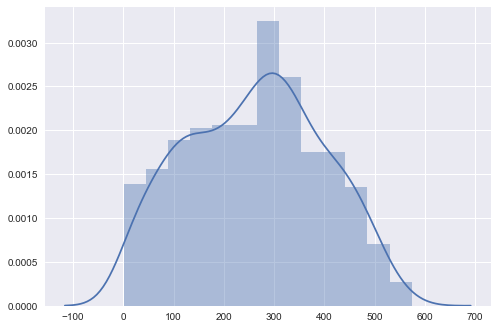

In [7]:
# components: is it connected?
comps = G.components()
# just take the giant
G = comps.giant()
# calculate degrees
G.vs["degree"] = G.degree()
print(summary(comps.giant()))
# distribution of degrees
sns.distplot(G.vs["degree"])

In [8]:
# plot the network
plot(G)

Select a clustering method and get a partition, good results can be obtained with any method below 

In [25]:
partition = louvain.find_partition(G, method='Modularity', weight='weight', resolution_parameter=1)
#partition = louvain.find_partition(G, method='RBConfiguration', weight='weight', resolution_parameter=1.2)
#partition = louvain.find_partition(G, method='Surprise', weight='weight')
print(len(set(partition.membership)))

5


In [26]:
# modularity
print(G.modularity(partition.membership,weights="weight"))

0.18627303704200893


In [27]:
# add community and weighted degree information into the network
for v,c in zip(G.vs,partition.membership):
    # update citers_info
    citers_info[v["bid"]]["community"] = c
    citers_info[v["bid"]]["weighted_degree"] = 0
for e in G.es:
    citers_info[G.vs[e.source]["bid"]]["weighted_degree"] += e["weight"]
    citers_info[G.vs[e.target]["bid"]]["weighted_degree"] += e["weight"]

Explore clusters

In [28]:
# for every cluster, in decreasing order of size, show the classification information
# this information was used to characterize the clusters as in Figure XXX
for c in sorted(set(partition.membership)):
    print("community %d"%c)
    print("size %d"%len([x for x in partition.membership if x==c]))
    # general categories
    gcs = defaultdict(int)
    # keywords
    kws = defaultdict(int)
    # periods
    ps = defaultdict(int)
    for v in citers_info.values():
        if 'community' in v.keys() and v['community'] == c:
            gcs[v["general_category"]] += 1
            for kw in v["keywords"]:
                kws[kw] += 1
            for p in v["periods"]:
                ps[p] += 1
    gcs = sorted(gcs.items(),key=lambda x:x[1],reverse=True)
    kws = sorted(kws.items(),key=lambda x:x[1],reverse=True)
    ps = sorted(ps.items(),key=lambda x:x[1],reverse=True)
    print(gcs)
    print(kws)
    print(ps)
    print("------")

community 0
size 217
[('history', 193), ('arts', 13), ('architecture', 11)]
[('social', 46), ('politics', 33), ('religion', 25), ('individuals', 24), ('government', 22), ('elites', 14), ('books', 13), ('gender', 12), ('culture', 12), ('literature', 11), ('war', 10), ('mainland', 10), ('empire', 8), ('crafts', 8), ('music', 8), ('commerce', 8), ('', 7), ('economics', 7), ('entertainment', 7), ('jews', 6), ('urban', 5), ('maritime', 5), ('myth', 5), ('guilds', 4), ('painting', 3), ('palaces', 3), ('health', 3), ('lagoon', 3), ('churches', 3), ('industry', 2), ('collecting', 2), ('intellectual', 2), ('arts', 2), ('public finance', 1), ('family', 1), ('finance', 1), ('schools', 1)]
[('renaissance', 121), ('xvii', 86), ('xviii', 80), ('', 19), ('middle ages', 15), ('xix', 12), ('recent', 3)]
------
community 1
size 200
[('architecture', 93), ('arts', 79), ('history', 28)]
[('churches', 36), ('painting', 34), ('urban', 25), ('individuals', 21), ('palaces', 17), ('social', 12), ('collecting',

In [29]:
# show the monographs in a given cluster
cm = 4 #choose the cluster
for v in citers_info.values():
    if "community" in v.keys() and v["community"]==cm:
        print(v)

{'community': 4, 'periods': [''], 'general_category': 'arts', 'keywords': ['crafts'], 'subjects': 'COLORAZIONE E TECNICHE CONNESSE. TINTURE NATURALI. Trattamento storico e geografico; VENEZIA - Congressi - 1996; PORPORA - Congressi - Venezia - 1996; Porpora - Studi', 'title_corrected': 'La porpora: realtà e immaginario di un colore simbolico : atti del Convegno di studio, Venezia, 24 e 25 ottobre 1996', 'weighted_degree': 13.0, 'typology': 'catalogue'}
{'community': 4, 'periods': [''], 'general_category': 'arts', 'keywords': ['crafts'], 'subjects': 'ARTE VETRARIA; ARTE VETRARIA - Venezia - Storia - Esposizioni - Venezia - 1982; ARTE VETRARIA - Storia - Esposizioni', 'title_corrected': 'Mille anni di arte del vetro a Venezia : Venezia, Palazzo Ducale Museo Correr, 24 luglio-24 ottobre 1982', 'weighted_degree': 87.0, 'typology': 'catalogue'}
{'community': 4, 'periods': ['xviii'], 'general_category': 'history', 'keywords': ['individuals'], 'subjects': 'VENEZIA <REPUBBLICA> - Storia - Sec.

Keep splitting the communities, as done for Section XXX

In [30]:
# Keep clustering
cm_tosplit = 0 #choose the cluster
G_sub = partition.subgraph(cm_tosplit)
sub_partition = louvain.find_partition(G_sub, method='Modularity', weight='weight')
print(len(set(sub_partition.membership)))
# modularity
print(G_sub.modularity(sub_partition.membership,weights="weight"))

5
0.1374044750656135


In [31]:
# explore metadata of the community similar as done above
for c in sorted(set(sub_partition.membership)):
    print("community %d"%c)
    print("size %d"%len([x for x in sub_partition.membership if x==c]))
    # general categories
    gcs = defaultdict(int)
    # keywords
    kws = defaultdict(int)
    # periods
    ps = defaultdict(int)
    # years
    yys = list()
    for n,m in zip(G_sub.vs,sub_partition.membership):
        if m == c:
            gcs[citers_info[n["bid"]]["general_category"]] += 1
            if metadata[n["bid"]]["year"]:
                yys.append(metadata[n["bid"]]["year"])
            for kw in citers_info[n["bid"]]["keywords"]:
                kws[kw] += 1
            for p in citers_info[n["bid"]]["periods"]:
                ps[p] += 1
    gcs = sorted(gcs.items(),key=lambda x:x[1],reverse=True)
    kws = sorted(kws.items(),key=lambda x:x[1],reverse=True)
    ps = sorted(ps.items(),key=lambda x:x[1],reverse=True)
    print(gcs)
    print(kws)
    print(ps)
    print("Median of publication years: "+str(int(np.nanmedian(yys))))
    print("------")

community 0
size 60
[('history', 56), ('arts', 2), ('architecture', 2)]
[('social', 12), ('politics', 12), ('government', 10), ('war', 7), ('religion', 5), ('jews', 5), ('commerce', 5), ('mainland', 5), ('economics', 4), ('individuals', 4), ('maritime', 3), ('empire', 3), ('urban', 2), ('elites', 2), ('health', 2), ('painting', 1), ('palaces', 1), ('public finance', 1), ('gender', 1), ('crafts', 1), ('collecting', 1), ('music', 1), ('finance', 1), ('culture', 1), ('schools', 1), ('churches', 1), ('arts', 1), ('entertainment', 1)]
[('renaissance', 42), ('xvii', 30), ('xviii', 14), ('middle ages', 4), ('', 3), ('xix', 2), ('recent', 1)]
Median of publication years: 2000
------
community 1
size 60
[('history', 55), ('arts', 3), ('architecture', 2)]
[('religion', 12), ('social', 11), ('books', 11), ('individuals', 10), ('politics', 9), ('culture', 6), ('', 5), ('literature', 5), ('elites', 4), ('government', 3), ('myth', 3), ('palaces', 2), ('crafts', 2), ('empire', 2), ('economics', 2), (

In [32]:
# explore a sub cluster
cm = 1
for n,v in zip(sub_partition.membership,G_sub.vs):
    if n==cm:
        print(metadata[v["bid"]]["author"]+" - "+citers_info[v["bid"]]["title_corrected"]+" - "+str(citers_info[v["bid"]]["weighted_degree"]))

Fletcher, Harry George - New Aldine studies : documentary essays on the life and work of Aldus Manutius - 227.0
Boholm, Åsa - The Doge of Venice : the symbolism of state power in the Renaissance - 412.0
Frajese, Vittorio - Sarpi scettico : Stato e Chiesa a Venezia tra Cinque e Seicento - 457.0
Calò, Luca - Giulio Gherlandi heretico ostinatissimo : un predicatore eterodosso del Cinquecento tra il Veneto e la Moravia - 180.0
McCray, W. Patrick - Glassmaking in Renaissance Venice : the fragile craft - 496.0
Pullan, Brian - Gli ebrei d'Europa e l'Inquisizione a Venezia dal 1550 al 1670 - 859.0
Curi Nicolardi, Silvia - Una società tipografico-editoriale a Venezia nel secolo 16. : Melchiorre Sessa e Pietro di Ravani, 1516-1525 - 70.0
Lowry, Martin - Il mondo di Aldo Manuzio : affari e cultura nella Venezia del Rinascimento - 434.0
Morris, Jan - Sotto il segno di san Marco - 121.0
Ruggiero, Guido - The boundaries of eros : sex crime and sexuality in Renaissance Venice - 503.0
King, Margaret L

Analysis of the co-citation network, as in Section XXX

In [33]:
Gcc = Graph.Read_GraphML("dataset/graphs/cocit_2.graphml")
summary(Gcc)

IGRAPH U-W- 9061 288782 -- 
+ attr: author (v), bid (v), core_age (v), core_type (v), field (v), id (v), in_lb (v), is_cited (v), is_citing (v), is_core (v), title (v), weight (e)


In [39]:
# get giant component and calculate centralities and its density
comps = Gcc.components()
print(summary(comps.giant()))
Gcc = comps.giant()
Gcc.vs["degree"] = Gcc.degree()
Gcc.vs["weighted_degree"] = [0 for _ in range(len(Gcc.vs))]
for e in Gcc.es:
    Gcc.vs[e.source]["weighted_degree"] += e["weight"]
    Gcc.vs[e.target]["weighted_degree"] += e["weight"]
Gcc.vs["betweenness"] = Gcc.betweenness(directed=False,weights="weight")
Gcc.vs["pagerank"] = Gcc.pagerank(directed=False,weights="weight")
Gcc.vs["local_clustering"] = Gcc.transitivity_local_undirected(mode="zero",weights="weight")
print(Gcc.density(loops=False))

IGRAPH U-W- 8988 288736 -- 
+ attr: author (v), bid (v), core_age (v), core_type (v), degree (v), field (v), id (v), in_lb (v), is_cited (v), is_citing (v), is_core (v), title (v), weight (e)
None
0.007149128873239193


In [40]:
# correlations, Table XXX
np.corrcoef([Gcc.vs["is_core"],Gcc.vs["degree"],Gcc.vs["weighted_degree"],Gcc.vs["betweenness"],Gcc.vs["pagerank"],Gcc.vs["local_clustering"]])

array([[ 1.        ,  0.66818738,  0.62808364,  0.42243402,  0.61898807,
        -0.41436427],
       [ 0.66818738,  1.        ,  0.99034538,  0.79621727,  0.97581505,
        -0.37558574],
       [ 0.62808364,  0.99034538,  1.        ,  0.84016885,  0.99171144,
        -0.35409497],
       [ 0.42243402,  0.79621727,  0.84016885,  1.        ,  0.88919443,
        -0.25781434],
       [ 0.61898807,  0.97581505,  0.99171144,  0.88919443,  1.        ,
        -0.35756673],
       [-0.41436427, -0.37558574, -0.35409497, -0.25781434, -0.35756673,
         1.        ]])

In [41]:
partition_cc = louvain.find_partition(Gcc, method='Modularity', weight='weight')
print(len(set(partition_cc.membership)))

15


In [42]:
# modularity
print(Gcc.modularity(partition_cc.membership,weights="weight"))

0.3974331237311216


(0, 3200)

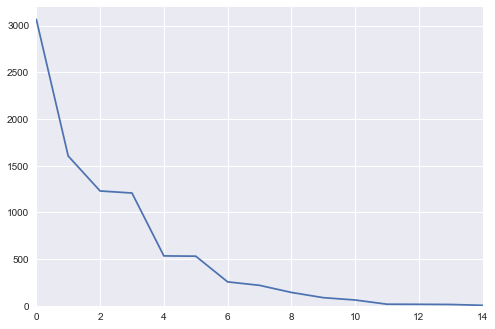

In [43]:
# size of clusters: 4 large ones, 6 minor, a few very small
plt.plot([len([x for x in partition_cc.membership if x == c]) for c in set(partition_cc.membership)])
plt.xlim((0,len(set(partition_cc.membership))-1))
plt.ylim((0,3200))

In [44]:
# bibc cluster contribution for every node in the cocit network: we calculate here the proportions of citations 
#received by every cluster of the co-citation network from the monographs in every cluster of the bib. coupling network. 
#The literature is evidently used coherently by groups of monographs in different clusters. 
cc_clusters_contribs = {x:{y:0 for y in set(partition.membership)} for x in set(partition_cc.membership)}
# every cited monograph contributes for 1 proportionally
for n,v in zip(partition_cc.membership,Gcc.vs):
    # get the citing monographs clusters
    clusters_citers = [citers_info[x]["community"] for x in metadata[v["bid"]]["cited"] if x in citers_info.keys()]
    # assign proportionally
    for ccc in set(clusters_citers):
        cc_clusters_contribs[n][ccc] += len([x for x in clusters_citers if x==ccc])/len(clusters_citers)
# divide all clusters by the number of nodes in the co citation network
for k,v in cc_clusters_contribs.items():
    for vv in v.keys():
        v[vv] /= len([x for x in partition_cc.membership if x == k])

In [45]:
# read as follows:
# cluster 0 in the co-citation network received 60% of its citations from monographs in cluster 0 of the bib. c. network, etc.
cc_clusters_contribs

{0: {0: 0.6062096708232872,
  1: 0.07765443574532527,
  2: 0.29036210711278565,
  3: 0.007416354357194513,
  4: 0.01835743196140727},
 1: {0: 0.07934393180248887,
  1: 0.8342419859962834,
  2: 0.03763631882236241,
  3: 0.014514634072624702,
  4: 0.0342631293062398},
 2: {0: 0.13240790503268185,
  1: 0.772507253106947,
  2: 0.0734141981730476,
  3: 0.0024610289526554416,
  4: 0.01920961473466763},
 3: {0: 0.0876308684144096,
  1: 0.35274346484231256,
  2: 0.5185568815685382,
  3: 0.008954902775322106,
  4: 0.03211388239941725},
 4: {0: 0.12632292328999178,
  1: 0.6356255518342625,
  2: 0.13914041672837132,
  3: 0.06842482195175123,
  4: 0.030486286195623716},
 5: {0: 0.33177322834426076,
  1: 0.1303972004969889,
  2: 0.12387611825373111,
  3: 0.009664541139414763,
  4: 0.4042889117656044},
 6: {0: 0.7502767407090503,
  1: 0.05767846046527603,
  2: 0.1686380532440473,
  3: 0.015426995222431078,
  4: 0.007979750359195402},
 7: {0: 0.07124605480769866,
  1: 0.0763107263107263,
  2: 0.02742

In [46]:
# explore clusters of the co-citation networks
cm = 12 # choose cluster
for n,v in zip(partition_cc.membership,Gcc.vs):
    if n==cm:
        print(metadata[v["bid"]]["author"]+" - "+metadata[v["bid"]]["title"]+" - "+str(v["degree"]))

Saunders, Harris Sheridan - The repertoire of a Venetian opera house (1678-1714) : the Teatro Grimani di San Giovanni Grisostomo - 15
Murata, Margaret - Operas for the Papal Court : 1631-1668 - 15
im Verbidung mit Wolfgang Osthoff, Herbert Schneider und Hellmuth Christian Wolff - Quellentexte zur Konzeption der europaischen Oper im 17. Jahrhundert - 15
Tamburini, Elena - Due teatri per il principe : studi sulla committenza teatrale di Lorenzo Onofrio Colonna, 1659-1689 - 15
Daolmi, Davide - Le origini dell'opera a Milano : (1598-1649 - 15
a cura di Emilio Sala e Davide Daolmi - Quel novo Cario, quel divin Orfeo: Antonio Draghi da Rimini a Vienna : atti del Convegno internazionale, Rimini, Palazzo Buonadrata, 5-7 ottobre 1998 - 15
Ricci, Corrado - I teatri di Bologna nei secoli 17. e 18. : storia aneddotica - 15
Maretto, Paolo - La casa veneziana : nella storia della citta dalle origini all'Ottocento - 4
Biblioteca nazionale Marciana - I codici musicali contariniani del secolo 17. nella

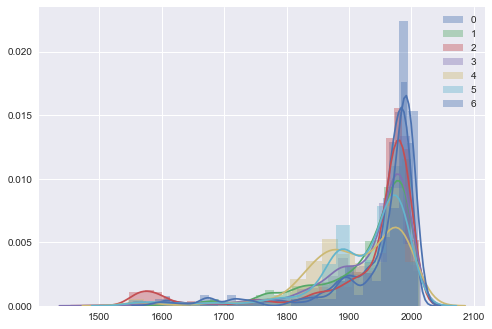

In [47]:
# the age of the cited literature grouped in clusters. E.g. clusters 2 and 4 have local peaks in the XVI and XIX centuries
#respectively, and they are especially used by cluster 1 in the bib. c. network: architecture and art history (see above).
for cc in range(7):
    years = [metadata[x["bid"]]["year"] for c,x in zip(partition_cc.membership,Gcc.vs) if metadata[x["bid"]]["year"] if c==cc]
    sns.distplot(years,label=str(cc))
plt.legend()

Alternative ways to detect core literature using central nodes in the co-citation network

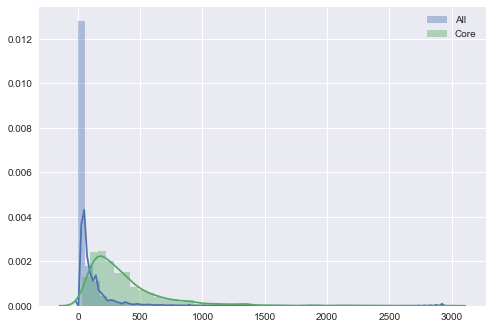

In [48]:
# centralities of the cocit network: degree
sns.distplot(Gcc.vs["degree"],label="All")
sns.distplot([x["degree"] for x in Gcc.vs if x["bid"] in core_info.keys()],label="Core")
plt.legend()

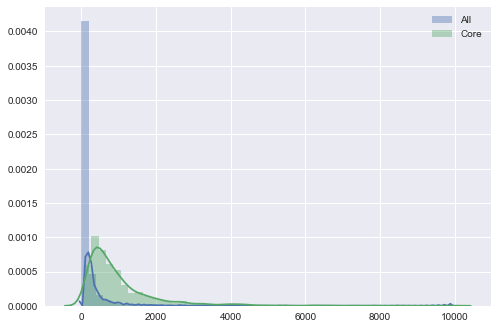

In [51]:
# centralities of the cocit network: weighted degree
sns.distplot(Gcc.vs["weighted_degree"],label="All")
sns.distplot([x["weighted_degree"] for x in Gcc.vs if x["bid"] in core_info.keys()],label="Core")
plt.legend()

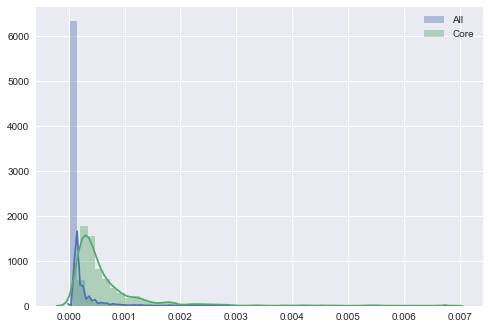

In [49]:
# centralities of the cocit network: Page rank
sns.distplot(Gcc.vs["pagerank"],label="All")
sns.distplot([x["pagerank"] for x in Gcc.vs if x["bid"] in core_info.keys()],label="Core")
plt.legend()

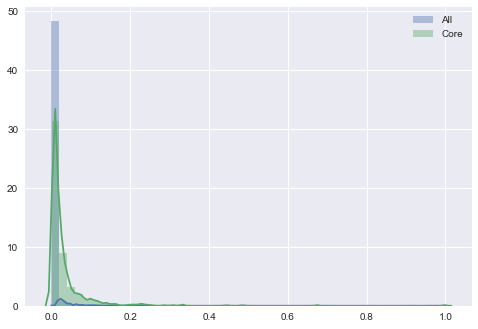

In [50]:
# centralities of the cocit network: betweenness
sns.distplot([x["betweenness"]/max(Gcc.vs["betweenness"]) for x in Gcc.vs],label="All")
sns.distplot([x["betweenness"]/max(Gcc.vs["betweenness"]) for x in Gcc.vs if x["bid"] in core_info.keys()],label="Core")
plt.legend()